In [ ]:
!pip install trimesh
!unzip urdf.zip -d urdf

Archive:  urdf.zip
   creating: urdf/urdf/baxter/
  inflating: urdf/urdf/baxter/baxter.urdf  
   creating: urdf/urdf/baxter/meshes/
   creating: urdf/urdf/baxter/meshes/base/
  inflating: urdf/urdf/baxter/meshes/base/PEDESTAL.dae  
  inflating: urdf/urdf/baxter/meshes/base/PEDESTAL.stl  
  inflating: urdf/urdf/baxter/meshes/base/pedestal_link_collision.dae  
  inflating: urdf/urdf/baxter/meshes/base/pedestal_link_collision.stl  
   creating: urdf/urdf/baxter/meshes/head/
  inflating: urdf/urdf/baxter/meshes/head/H0.stl  
  inflating: urdf/urdf/baxter/meshes/head/H1.stl  
   creating: urdf/urdf/baxter/meshes/lower_elbow/
  inflating: urdf/urdf/baxter/meshes/lower_elbow/E1.stl  
   creating: urdf/urdf/baxter/meshes/lower_forearm/
  inflating: urdf/urdf/baxter/meshes/lower_forearm/W1.stl  
   creating: urdf/urdf/baxter/meshes/lower_shoulder/
  inflating: urdf/urdf/baxter/meshes/lower_shoulder/S1.stl  
   creating: urdf/urdf/baxter/meshes/torso/
  inflating: urdf/urdf/baxter/meshes/torso/b

# Import Packages

In [ ]:
from copy import deepcopy

import numpy as np
import xml.etree.ElementTree as ET
import trimesh


import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D, art3d

# To solve the midterm project, you have the option to utilize pre-existing utility functions from core.py or to use the following provided utility functions. Either way will be fine.

# Utility functions for visualization

### Function: convert_string_to_narray
  - Purpose: Converts a space-separated string of numerical values into a NumPy array of floats.
  - Input: A string containing space-separated numerical values (e.g., "1.0 2.0 3.0").
  - Output: A NumPy array of floats derived from the input string.

### Function: print_link_tree
  - Purpose: Recursively prints the hierarchy of links and joints in a robot structure starting from a given link.
  - Input: The root link of the robot from which to start printing.
  - Output: Prints the names of links and their child joints to the console.

### Function: print_link_positions
  - Purpose: Recursively prints the positions of each link in a robot, derived from its transformation matrix.
  - Input: The root link of the robot.
  - Output: Console output showing each link's name along with its position in 3D space.

### Function: draw_frame
  - Purpose: Draws the X, Y, and Z axes of a frame in a 3D plot, based on a given transformation matrix.
  - Inputs:
    - ax: A Matplotlib 3D axis object.
    - T: The transformation matrix defining the frame's orientation and position.
    - name: Label for the frame.
    - scale: Scale of the axes (optional, default is 0.3).
  - Output: Draws the axes on the provided 3D plot.

### Function: visualize_robot_frames_with_axes
  - Purpose: Visualizes all the frames of a robot's links with axes in a 3D plot.
  - Input: The root link of the robot.
  - Output: A 3D plot showing all frames of the robot.

### Function: visualize_robot_with_meshes
  - Purpose: Visualizes the robot by combining and displaying meshes for each link, assuming mesh paths and transformations are correctly set.
  - Input: The root link of the robot.
  - Output: Displays a 3D visualization of the robot with all combined meshes.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import trimesh

def convert_string_to_narray(str_input):
    """
    Converts a space-separated string of numbers into a numpy array of floats.

    Args:
        str_input (str): A string containing space-separated numbers.

    Returns:
        numpy.ndarray: An array of floating point numbers.
    """
    return np.array([float(data) for data in str_input.split()])

def print_link_tree(link, level=0):
    """
    Recursively prints the hierarchical tree of robot links and joints,
    showing the structure from any starting link.

    Args:
        link (Link object): The current link in the robot structure.
        level (int): The current depth in the recursion (used for indentation).

    Returns:
        None: Outputs information to the console.
    """
    indent = "  " * level  # Create indentation based on recursion level
    print(f"{indent}Link: {link.name}")
    for child_joint in link.children:
        print(f"{indent}  Joint: {child_joint.name} -> {child_joint.child_link.name}")
        print_link_tree(child_joint.child_link, level + 1)

def print_link_positions(link, level=0):
    """
    Recursively prints the position of each link in the robot structure,
    derived from its transformation matrix.

    Args:
        link (Link object): The current link in the robot structure.
        level (int): The current depth in the recursion (used for indentation).

    Returns:
        None: Outputs positions to the console.
    """
    indent = "  " * level
    position = link.transformation[:3, 3]  # Extract translation from transformation matrix
    print(f"{indent}Link: {link.name}, Position: {position}")
    for child_joint in link.children:
        print_link_positions(child_joint.child_link, level + 1)

def draw_frame(ax, T, name, scale=0.3):
    """
    Draws the coordinate frame axes for a given transformation matrix.

    Args:
        ax (matplotlib.axes._subplots.Axes3DSubplot): The 3D subplot to draw on.
        T (numpy.ndarray): 4x4 transformation matrix defining the frame.
        name (str): Name of the frame to label in the plot.
        scale (float): Scale factor for drawing the axes.

    Returns:
        None: The frame is drawn on the given plot.
    """
    origin = T[:3, 3]  # Extract the origin point
    # Compute the directions of the axes transformed by the rotation matrix
    x_dir = T[:3, :3] @ np.array([scale, 0, 0])
    y_dir = T[:3, :3] @ np.array([0, scale, 0])
    z_dir = T[:3, :3] @ np.array([0, 0, scale])
    # Plot each axis using quiver
    ax.quiver(*origin, *x_dir, color='r', length=scale, normalize=True)
    ax.quiver(*origin, *y_dir, color='g', length=scale, normalize=True)
    ax.quiver(*origin, *z_dir, color='b', length=scale, normalize=True)
    ax.text(*origin, name, color='black')  # Label the frame

def visualize_robot_frames_with_axes(root_link):
    """
    Visualizes all frames in a robot structure using axes to represent each link's frame.

    Args:
        root_link (Link object): The root link from which to start the visualization.

    Returns:
        None: A 3D plot is displayed showing all link frames.
    """
    fig = plt.figure(figsize=(24, 24))
    ax = fig.add_subplot(111, projection='3d')
    # Recursive function to draw each link's frame
    def recurse_links(link):
        draw_frame(ax, link.transformation, link.name)
        for child_joint in link.children:
            recurse_links(child_joint.child_link)
    recurse_links(root_link)  # Start recursion from the root link
    ax.set_xlim([-1, 1]), ax.set_ylim([-1, 1]), ax.set_zlim([-1, 1])
    ax.view_init(20, -90)  # Set the viewing angle
    plt.show()

def visualize_robot_with_meshes(link):
    """
    Visualizes a robot by combining and displaying 3D meshes for each link.

    Args:
        link (Link object): The root link from which to start the mesh combination.

    Returns:
        None: Displays a combined 3D visualization of all robot meshes.
    """
    def recurse_mesh_combine(_link):
        combined_mesh = None
        for visual in _link.visuals:
            if visual.filename is not None:
                filename = visual.filename
                T_link_to_mesh = rpy_position_to_transformation(visual.origin_orientation, visual.origin_position)
                mesh = trimesh.load_mesh(filename)
                mesh.apply_transform(_link.transformation @ T_link_to_mesh)
                combined_mesh = mesh if combined_mesh is None else combined_mesh + mesh
        for child_joint in _link.children:
            combined_mesh += recurse_mesh_combine(child_joint.child_link)
        return combined_mesh
    combined_mesh = recurse_mesh_combine(link)
    display(combined_mesh.show())  # Display the combined mesh using trimesh's built-in viewer

# Utility functions for rotation matrix, transformation, matrix exponential.

### Function: `rpy_to_rotation_matrix`

**Purpose**: Convert Roll-Pitch-Yaw (RPY) angles to a corresponding rotation matrix.

**Usage**:
- **Input**: `rpy` (tuple) - a tuple of three angles (roll, pitch, yaw) in radians.
- **Output**: (numpy.ndarray) - a 3x3 rotation matrix.

### Function: `quaternion_to_rotation_matrix`

**Purpose**: Convert a quaternion to a rotation matrix.

**Usage**:
- **Input**: `q` (numpy.ndarray) - a quaternion as a numpy array [w, x, y, z].
- **Output**: (numpy.ndarray) - a 3x3 rotation matrix.

### Function: `rotation_matrix_to_rpy`

**Purpose**: Convert a rotation matrix to Roll-Pitch-Yaw (RPY) angles.
**Usage**:
- **Input**: `R` (numpy.ndarray) - a 3x3 rotation matrix.
- **Output**: (tuple) - a tuple of RPY angles in degrees.

### Function: `slerp`

**Purpose**: Perform Spherical Linear Interpolation (SLERP) between two quaternions.
**Usage**:
- **Input**:
  - `q1`, `q2` (numpy.ndarray) - start and end quaternions.
  - `t` (float) - interpolation parameter between 0 and 1.
- **Output**: (numpy.ndarray) - interpolated quaternion.

### Function: `angular_velocity_to_skew_symmetric`

**Purpose**: Convert an angular velocity vector to a skew-symmetric matrix.
**Usage**:
- **Input**: `omega` (numpy.ndarray) - angular velocity vector.
- **Output**: (numpy.ndarray) - corresponding skew-symmetric matrix.

### Function: `exponential_map_rotation`

**Purpose**: Compute the rotation matrix using the exponential map given an axis and a rotation angle.
**Usage**:
- **Input**:
  - `axis` (numpy.ndarray) - rotation axis.
  - `theta` (float) - rotation angle in radians.
- **Output**: (numpy.ndarray) - resulting rotation matrix.

### Function: `rpy_position_to_transformation`

**Purpose**: Compute the homogeneous transformation matrix using Roll-Pitch-Yaw (RPY) angles and a position vector.
**Usage**:
- **Input**:
  - `rpy` (tuple) - RPY angles.
  - `position` (numpy.ndarray) - position vector.
- **Output**: (numpy.ndarray) - 4x4 homogeneous transformation matrix.

### Function: `rotation_matrix_position_to_transformation`

**Purpose**: Combine a rotation matrix and a position vector into a homogeneous transformation matrix.
**Usage**:
- **Input**:
  - `R` (numpy.ndarray) - a 3x3 rotation matrix.
  - `p` (numpy.ndarray) - a position vector.
- **Output**: (numpy.ndarray) - a 4x4 homogeneous transformation matrix.

In [ ]:
def rpy_to_rotation_matrix(rpy):
    """Convert RPY (roll, pitch, yaw) angles to a rotation matrix."""
    roll, pitch, yaw = rpy
    Rx = np.array([
        [1, 0, 0],
        [0, np.cos(roll), -np.sin(roll)],
        [0, np.sin(roll), np.cos(roll)]
    ])
    Ry = np.array([
        [np.cos(pitch), 0, np.sin(pitch)],
        [0, 1, 0],
        [-np.sin(pitch), 0, np.cos(pitch)]
    ])
    Rz = np.array([
        [np.cos(yaw), -np.sin(yaw), 0],
        [np.sin(yaw), np.cos(yaw), 0],
        [0, 0, 1]
    ])
    R = Rz @ Ry @ Rx
    return R

def quaternion_to_rotation_matrix(q):
    w, x, y, z = q / np.linalg.norm(q)  # Ensure quaternion is normalized
    R = np.array([
        [1 - 2*y**2 - 2*z**2, 2*x*y - 2*z*w, 2*x*z + 2*y*w],
        [2*x*y + 2*z*w, 1 - 2*x**2 - 2*z**2, 2*y*z - 2*x*w],
        [2*x*z - 2*y*w, 2*y*z + 2*x*w, 1 - 2*x**2 - 2*y**2]
    ])
    return R

def rotation_matrix_to_rpy(R):
    pitch = np.arcsin(-R[2, 0])
    roll = np.arctan2(R[2, 1], R[2, 2])
    yaw = np.arctan2(R[1, 0], R[0, 0])
    # Convert radians to degrees
    roll, pitch, yaw = np.degrees([roll, pitch, yaw])
    return roll, pitch, yaw

def slerp(q1, q2, t):
    dot = np.dot(q1, q2)
    # If dot product is negative, the quaternions have opposite handedness and slerp won't take
    # the shorter path. Fix by reversing one quaternion.
    if dot < 0.0:
        q1 = -q1
        dot = -dot
    dot = np.clip(dot, -1.0, 1.0)  # Clamp dot product to stay within domain of acos()
    theta_0 = np.arccos(dot)  # Angle between input vectors
    sin_theta_0 = np.sin(theta_0)

    if sin_theta_0 < 1e-6:
        return (1.0 - t) * q1 + t * q2  # If the angle is small, use linear interpolation

    sin_theta_t = np.sin(theta_0 * t)
    sin_theta_1_t = np.sin(theta_0 * (1 - t))

    s1 = sin_theta_1_t / sin_theta_0
    s2 = sin_theta_t / sin_theta_0

    return s1 * q1 + s2 * q2

def angular_velocity_to_skew_symmetric(omega):
    omega_x, omega_y, omega_z = omega
    skew_symmetric = np.array([
        [0, -omega_z, omega_y],
        [omega_z, 0, -omega_x],
        [-omega_y, omega_x, 0]
    ])
    return skew_symmetric

def exponential_map_rotation(axis, theta):
    if np.abs(theta) < np.finfo(float).eps:
        return np.eye(3)
    skew_symmetric = angular_velocity_to_skew_symmetric(axis)
    R = np.eye(3) + np.sin(theta) * skew_symmetric + (1 - np.cos(theta)) * skew_symmetric @ skew_symmetric
    return R

def rpy_position_to_transformation(rpy, position):
    """Compute the homogeneous transformation matrix using RPY and origin."""
    R = rpy_to_rotation_matrix(rpy)
    T = np.eye(4)
    T[:3, :3] = R
    T[:3, 3] = position
    return T

def rotation_matrix_position_to_transformation(R, p):
    T = np.eye(4)
    T[:3, :3] = R
    T[:3, 3] = p
    return T

def transformation_to_rotation_matrix_position(T):
    R = T[:3, :3]
    p = T[:3, 3]
    return R, p

def twist_to_transformation(omega, v, theta):
    """Compute the homogeneous transformation matrix for a given twist and angle"""
    R = exponential_map_rotation(omega, theta)  # Rotation matrix from exponential map of omega
    p = (np.eye(3)*theta + (1.-np.cos(theta))*R + (theta - np.sin(theta))*R@R) @ v
    T = np.eye(4)
    T[:3, :3] = R
    T[:3, 3] = p
    return T

def rotation_matrix_to_omega(R, EPS=float(1e-12)):
    # referred p36
    el = np.array([[R[2, 1] - R[1, 2]], [R[0, 2] - R[2, 0]], [R[1, 0] - R[0, 1]]])
    norm_el = np.linalg.norm(el)
    if norm_el > EPS:
        w = np.dot(np.arctan2(norm_el, np.trace(R) - 1) / norm_el, el)
    elif R[0, 0] > 0 and R[1, 1] > 0 and R[2, 2] > 0:
        w = np.zeros((3, 1))
    else:
        w = np.dot(np.pi / 2, np.array([[R[0, 0] + 1], [R[1, 1] + 1], [R[2, 2] + 1]]))
    return w

def Adjoint(T):
    """Computes the adjoint representation of a homogeneous transformation
    matrix

    :param T: A homogeneous transformation matrix
    :return: The 6x6 adjoint representation [AdT] of T

    Example Input:
        T = np.array([[1, 0,  0, 0],
                      [0, 0, -1, 0],
                      [0, 1,  0, 3],
                      [0, 0,  0, 1]])
    Output:
        np.array([[1, 0,  0, 0, 0,  0],
                  [0, 0, -1, 0, 0,  0],
                  [0, 1,  0, 0, 0,  0],
                  [0, 0,  3, 1, 0,  0],
                  [3, 0,  0, 0, 0, -1],
                  [0, 0,  0, 0, 1,  0]])
    """
    R, p = transformation_to_rotation_matrix_position(T)
    return np.r_[np.c_[R, np.zeros((3, 3))],
                 np.c_[np.dot(angular_velocity_to_skew_symmetric(p), R), R]]

# Robot Model Classes Constructor Documentation

### Class: `Visual`

**Constructor**: Initializes a visual representation of a robot link.
- **Parameters**:
  - `origin_position` (list or tuple): The position of the visual relative to the link.
  - `origin_orientation` (list or tuple): The orientation of the visual relative to the link, typically in RPY (roll, pitch, yaw) format.
  - `geometry_type` (str): The type of geometry, such as 'mesh', 'box', 'sphere', etc.
  - `filename` (str): Path to the geometry file, if applicable.
  - `color` (tuple): RGB color tuple for the visual.

### Class: `Collision`

**Constructor**: Initializes collision detection parameters for a robot link.
- **Parameters**:
  - `origin_position` (list or tuple): The position of the collision geometry relative to the link.
  - `origin_orientation` (list or tuple): The orientation of the collision geometry relative to the link.
  - `geometry_type` (str): The type of geometry used for collision detection.
  - `filename` (str, optional): Path to the geometry file used for collision detection, applicable for mesh geometries.
  - `parameters` (dict, optional): Additional parameters for the collision geometry, such as dimensions.

### Class: `Link`

**Constructor**: Initializes a robot link with containers for visuals, collisions, and child links.
- **Parameters**:
  - `name` (str): The name of the link.
  - `transformation` (ndarray, optional): Initial transformation matrix of the link.

### Class: `Joint`

**Constructor**: Initializes a joint that connects two robot links.
- **Parameters**:
  - `name` (str): The name of the joint.
  - `joint_type` (str): The type of the joint, e.g., 'revolute', 'prismatic'.
  - `parent_link` (Link object): The parent link to which the joint is attached.
  - `child_link` (Link object): The child link to which the joint is connected.
  - `origin_position` (list or tuple): The position of the joint relative to the parent link.
  - `origin_orientation` (list or tuple): The orientation of the joint relative to the parent link.
  - `axis` (list or tuple): The axis of rotation or translation for the joint.
  - `limits` (dict, optional): Constraints on the joint's movement, such as minimum and maximum angles for revolute joints.

In [ ]:
class Visual:
    def __init__(self, origin_position, origin_orientation, geometry_type, filename, color):
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.geometry_type = geometry_type
        self.filename = filename
        self.color = color

class Collision:
    def __init__(self, origin_position, origin_orientation, geometry_type, filename=None, parameters=None):
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.geometry_type = geometry_type
        self.filename = filename
        self.parameters = parameters

class Link:
    def __init__(self, name, transformation=np.eye(4)):
        self.name = name
        self.visuals = []
        self.collisions = []
        self.children = []
        self.transformation = transformation

class Joint:
    def __init__(self, name, joint_type, parent_link, child_link, origin_position, origin_orientation, axis, limits=None):
        self.name = name
        self.joint_type = joint_type
        self.parent_link = parent_link
        self.child_link = child_link
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.axis = axis
        self.limits = limits

# URDF parser

In [ ]:
def parse_geometry(element, prefix='./'):
    geometry_type = list(element.find('geometry'))[0].tag
    filename = None
    parameters = {}
    if geometry_type == 'mesh':
        filename = prefix+element.find('geometry/mesh').attrib['filename']
    elif geometry_type in ['box', 'cylinder', 'sphere']:
        parameters = element.find(f'geometry/{geometry_type}').attrib
    return geometry_type, filename, parameters

def parse_limits(element):
    if element is None:
        return None
    limits = {'lower': element.attrib.get('lower'),
              'upper': element.attrib.get('upper'),
              'effort': element.attrib.get('effort'),
              'velocity': element.attrib.get('velocity')}
    return limits

def parse_urdf(urdf_path,prefix='./'):
    tree = ET.parse(prefix+urdf_path)
    root = tree.getroot()

    links = {}
    joints = {}

    for elem_link in root.findall('link'):
        link = Link(elem_link.attrib['name'])

        # Process visual elements
        for visual in elem_link.findall('visual'):
            origin = visual.find('origin')
            origin_pos = convert_string_to_narray(origin.attrib.get('xyz') if origin is not None else '0 0 0')
            origin_orient = convert_string_to_narray(origin.attrib.get('rpy') if origin is not None else '0 0 0')
            geom_type, filename, params = parse_geometry(visual, prefix=prefix)
            color = visual.find('material/color').attrib.get('rgba') if visual.find('material/color') is not None else 'N/A'
            link.visuals.append(Visual(origin_pos, origin_orient, geom_type, filename, color))

        # Process collision elements
        for collision in elem_link.findall('collision'):
            origin = collision.find('origin')
            origin_pos = convert_string_to_narray(origin.attrib.get('xyz') if origin is not None else '0 0 0')
            origin_orient = convert_string_to_narray(origin.attrib.get('rpy') if origin is not None else '0 0 0')
            geom_type, filename, params = parse_geometry(collision, prefix=prefix)
            link.collisions.append(Collision(origin_pos, origin_orient, geom_type, filename, params))

        links[link.name] = link

    # Parse joints
    for elem_joint in root.findall('joint'):
        origin = elem_joint.find('origin')
        origin_pos = convert_string_to_narray(origin.attrib.get('xyz') if origin is not None else '0 0 0')
        origin_orient = convert_string_to_narray(origin.attrib.get('rpy') if origin is not None else '0 0 0')
        axis = elem_joint.find('axis')
        xyz_axis = convert_string_to_narray(axis.attrib.get('xyz') if axis is not None else '0 0 0')
        limits = parse_limits(elem_joint.find('limit'))

        joint = Joint(name=elem_joint.attrib['name'],
                      joint_type=elem_joint.attrib['type'],
                      parent_link=links[elem_joint.find('parent').attrib['link']],
                      child_link=links[elem_joint.find('child').attrib['link']],
                      origin_position=origin_pos,
                      origin_orientation=origin_orient,
                      axis=xyz_axis,
                      limits=limits)
        joints[joint.name] = joint
        links[joint.parent_link.name].children.append(joint)

    root_link = next(link for link in links.values() if not any(joint.child_link == link for joint in joints.values()))
    return root_link, links, joints

# Revisit: Recursive Forward Kinematics

Robot Structure:
Link: panda_link_0
  Joint: panda_pedestal_fixed -> panda_pedestal
  Link: panda_pedestal
  Joint: panda_controller_box_fixed -> panda_controller_box
  Link: panda_controller_box
  Joint: panda_pedestal_feet_fixed -> panda_pedestal_feet
  Link: panda_pedestal_feet
  Joint: panda_joint1 -> panda_link_1
  Link: panda_link_1
    Joint: panda_joint2 -> panda_link_2
    Link: panda_link_2
      Joint: panda_joint3 -> panda_link_3
      Link: panda_link_3
        Joint: panda_joint4 -> panda_link_4
        Link: panda_link_4
          Joint: panda_joint5 -> panda_link_5
          Link: panda_link_5
            Joint: panda_joint6 -> panda_link_6
            Link: panda_link_6
              Joint: panda_joint7 -> panda_link_7
              Link: panda_link_7
                Joint: right_hand_fixed -> right_hand
                Link: right_hand
                  Joint: panda_right_gripper_fixed -> right_gripper
                  Link: right_gripper
                    Joint: p

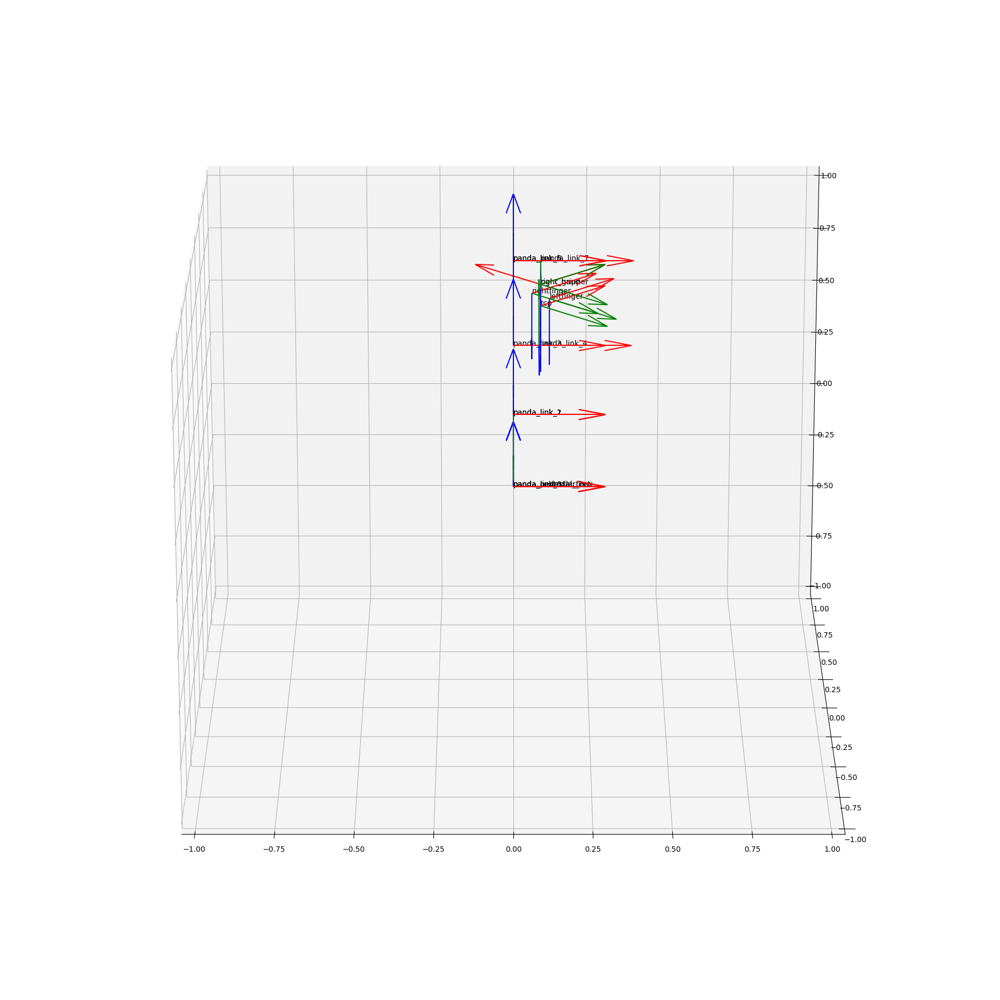

In [ ]:
def forward_kinematics(link, offset_transformation=np.eye(4), thetas={}):
    """Recursively compute the forward kinematics."""
    # Update the transformation for this link
    link.transformation = offset_transformation
    for child_joint in link.children:
        # Assuming revolute joints around the z-axis for simplicity
        T_theta = np.eye(4)
        if child_joint.joint_type == 'revolute':
          theta = thetas.get(child_joint.name, 0.0)
          rotation_axis = child_joint.axis
          R_theta = exponential_map_rotation(rotation_axis,theta)
          T_theta[:3, :3] = R_theta
        elif child_joint.joint_type == 'prismatic':
          theta = thetas.get(child_joint.name, 0.0)
          prismatic_axis = child_joint.axis
          T_theta[:3, 3] = theta*prismatic_axis
        elif child_joint.joint_type == 'fixed':
          T_theta = np.eye(4)

        T_joint_to_child = rpy_position_to_transformation(child_joint.origin_orientation, child_joint.origin_position)
        # Compute the transformation for the child link
        child_transformation = offset_transformation @ T_joint_to_child @ T_theta
        forward_kinematics(child_joint.child_link, child_transformation, thetas)

# Example usage
# Load the robot structure from the URDF file (see previous step)
prefix = './urdf/urdf/panda/'
urdf_path = 'panda.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)
print("Robot Structure:")
print_link_tree(root_link)

# Compute forward kinematics with an example joint angle
curr_thetas = {'panda_joint1':0.,
               'panda_joint2':0.,
               'panda_joint3':0.,
               'panda_joint4':0.,
               'panda_joint5':0.,
               'panda_joint6':0.,
               'panda_joint7':0.}
forward_kinematics(root_link,thetas=curr_thetas)

# Print the positions of each link
print("Link Positions:")
print_link_positions(root_link)
visualize_robot_frames_with_axes(root_link)
visualize_robot_with_meshes(root_link)

#Find the Pose of the 'TCP' Frame in 'Panda'

1. Write a Python function to search for a link with a specified name in the robot's structure.
2. If found, print the link's name and its transformation matrix, which includes the position (translation component) and orientation (rotation component).
3. If no link is found, print a message indicating that the link was not found.
4. By using this function, find the transformation matrix of 'tcp' frame of the 'panda' robot.

**Input**:

- `root_link`: The root link of the robot, which serves as the starting point for the search.
- `name`: The name of the link to search for, provided as a string.

**Output**:

- If the link is found: Print the link's name, position, and the entire transformation matrix.
- If the link is not found: Print a message stating that the link with the specified name was not found.

In [ ]:
def find_link_by_name(link, name='tcp'):
    """
    Recursively searches for a link with a specific name in the hierarchy of robot links.

    Args:
        link (Link): The starting link for the search.
        name (str, optional): The name of the link to find. Defaults to 'tcp'.

    Returns:
        Link or None: Returns the Link object if a link with the specified name is found,
                      or None if no link with that name exists in the hierarchy starting from the provided link.
    """

    # Check if the current link's name matches the target name. If yes, return the link as it is the one we are searching for.
    if link.name == name:
        return link

    # If the current link is not the target, iterate through all of its child joints.
    for child_joint in link.children:

        # Recursively call find_link_by_name on the child link of the current joint.
        # This explores the subtree rooted at this child link.
        found_link = find_link_by_name(child_joint.child_link, name)

        # If the recursive call found the target link in the subtree, return this link.
        # This passes the found link up the recursion chain.
        if found_link is not None:
            return found_link

    # If the target link was not found in this link or any of its subtrees, return None.
    # This signals that the search in this part of the hierarchy did not find the target link.
    return None

prefix = './urdf/urdf/panda/'
urdf_path = 'panda.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)
tcp_link = find_link_by_name(root_link, 'tcp')
if tcp_link is not None:
    print(f"Found link '{tcp_link.name}' with transformation matrix:")
    eef_position = tcp_link.transformation[:3, -1]
    print(f"EEF position: {eef_position}")
    print(f"EEF transformation: {tcp_link.transformation}")
else:
    print("Link with name 'tcp' was not found.")

Found link 'tcp' with transformation matrix:
EEF position: [0. 0. 0.]
EEF transformation: [[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


#Compute the Jacobian Matrix
1. Perform forward kinematics to update the poses of all links in the robot.
2. Locate the 'tcp' (Tool Center Point) link to use as the end-effector.
3. Compute the Jacobian matrix for the robot, taking into account both revolute and prismatic joints.

**Input**:

- `_root_link`: The root link of the robot, serving as the starting point for computations.
- `_thetas`: A dictionary where keys are joint names and values are the current angles or displacements of the joints.

**Output**:

- The Jacobian matrix for the robot at the specified joint configuration.

---

# Jacobian Matrix in Robotics

The **Jacobian matrix** is crucial in robotics for mapping joint velocity vectors to the velocity vector of the robot's end-effector in the workspace. It plays a key role in various robotics applications such as motion control, simulation, and inverse kinematics.

### Structure of the Jacobian Matrix

The Jacobian matrix, denoted as $( J )$, has a dimension of $( 6 \times n )$ for a robotic arm with $( n )$ joints. The matrix is divided into:
- **Top three rows**: Represent the linear velocities, linking joint velocities to the translational motion of the end-effector.
- **Bottom three rows**: Correspond to the angular velocities, linking joint velocities to the rotational motion of the end-effector.

### Formula for Computing the Jacobian

The contributions to the Jacobian matrix vary based on the type of joint:

#### Revolute Joint
For a revolute joint:
- **Angular Velocity Vector $( \mathbf{w} )$**: The rotation axis of the joint, transformed to the end-effector's coordinate frame.
- **Linear Velocity Vector $( \mathbf{v} )$**:

  $\mathbf{v} = \mathbf{w} \times ( \mathbf{p}_{\text{eff}} - \mathbf{p}_{\text{joint}})$

  where $( \mathbf{p}_{\text{eff}} )$ is the position of the end-effector and $( \mathbf{p}_{\text{joint}} )$ is the position of the joint.

#### Prismatic Joint
For a prismatic joint:
- **Angular Velocity Vector $( \mathbf{w} )$**: A zero vector, indicating no rotational contribution.
- **Linear Velocity Vector $( \mathbf{v} )$**: The translation direction of the joint, transformed to the end-effector's coordinate frame.

### Construction of the Jacobian Matrix

The Jacobian is constructed by placing the linear and angular velocity vectors for each joint into the matrix:

$
J = \begin{bmatrix}
\mathbf{v}_1 & \mathbf{v}_2 & \cdots & \mathbf{v}_n \\
\mathbf{w}_1 & \mathbf{w}_2 & \cdots & \mathbf{w}_n
\end{bmatrix}
$


In [ ]:
def compute_jacobian(_root_link, _thetas={}):
    """
    Compute the Jacobian matrix for a given robot configuration.

    Args:
        _root_link (Link): The base link of the robot from which to start the computation.
        _thetas (dict): Dictionary of joint names to their current angles or translations.

    Returns:
        numpy.ndarray: The Jacobian matrix describing the relationship between joint velocities and the end-effector's linear and angular velocities.
    """

    # Perform forward kinematics to update the positions and orientations of all links based on current joint angles.
    forward_kinematics(_root_link, thetas=_thetas)
    # Find the link designated as 'tcp' (tool center point) which acts as the end-effector.
    tcp_link = find_link_by_name(_root_link, name='tcp')
    # Extract the position vector of the end-effector from its transformation matrix.
    p_eef = tcp_link.transformation[:3, 3]
    # Determine the number of joints (degrees of freedom) for the robot.
    dof = len(_thetas)
    # Initialize the Jacobian matrix with zeros. It has 6 rows (for spatial velocity) and columns equal to the number of joints.
    jacobian = np.zeros((6, dof))

    # Initialize an index to track the current column of the Jacobian matrix corresponding to each joint.
    joint_index = 0

    # Iterate over each joint in the robot to compute its contribution to the Jacobian matrix.
    for joint in _thetas:
        # Retrieve the joint object from a global dictionary of joints.
        joint_obj = joints[joint]
        # Access the link that this joint leads to.
        child_link = joint_obj.child_link
        # Decompose the transformation matrix of the child link to get the rotation matrix and position vector.
        T_child = child_link.transformation
        R_child = T_child[:3, :3]
        p_joint = T_child[:3, 3]
        # Handle different types of joints to calculate their contributions to the Jacobian matrix.
        if joint_obj.joint_type == 'revolute':
            # Increment the joint index (used for column indexing in the Jacobian matrix).
            joint_index += 1
            # Calculate the angular velocity vector for the revolute joint, which is the rotation axis transformed by the current link's orientation.
            S_j = R_child @ joint_obj.axis
            # Calculate the linear velocity vector using the cross product of the angular velocity and the vector from the joint to the end-effector.
            v_j = np.cross(S_j, p_eef - p_joint)
            # Place the linear and angular velocities in the corresponding column of the Jacobian matrix.
            jacobian[:, joint_index - 1] = np.concatenate((v_j, S_j))

        elif joint_obj.joint_type == 'prismatic':
            # Increment the joint index for the Jacobian matrix.
            joint_index += 1
            # For prismatic joints, the angular velocity is zero.
            S_j = np.zeros(3)
            # The linear velocity is the translation axis transformed by the current link's orientation.
            v_j = R_child @ joint_obj.axis
            # Update the Jacobian matrix with the linear and angular velocities for the prismatic joint.
            jacobian[:, joint_index - 1] = np.concatenate((v_j, S_j))


    # Return the computed Jacobian matrix.
    return jacobian

# Compute forward kinematics with an example joint angle
prefix = './urdf/urdf/panda/'
urdf_path = 'panda.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)
curr_thetas = {'panda_joint1':0.,
               'panda_joint2':-np.pi/4.,
               'panda_joint3':0.,
               'panda_joint4':-3.*np.pi/4.,
               'panda_joint5':0.,
               'panda_joint6':np.pi/2.,
               'panda_joint7':np.pi/4.}
jacobian = compute_jacobian(root_link, _thetas=curr_thetas)
print(jacobian)

[[ 5.89015911e-12  1.60782052e-01  3.30143954e-12  1.21000000e-01
   2.40565719e-12  2.03500000e-01  2.01948392e-28]
 [ 3.06890567e-01  1.50271693e-12  3.30694480e-01  1.19422712e-13
   2.03500000e-01 -1.23071680e-12 -2.46578656e-17]
 [-0.00000000e+00 -3.06890567e-01  2.63071391e-12  4.72000000e-01
  -9.78301534e-13  8.80000000e-02  1.70751339e-28]
 [ 0.00000000e+00  0.00000000e+00 -7.07106781e-01 -6.92482238e-12
   1.00000000e+00 -6.92482238e-12 -1.21168873e-16]
 [ 0.00000000e+00  1.00000000e+00  1.43417767e-12 -1.00000000e+00
  -1.18214112e-11 -1.00000000e+00 -6.92482238e-12]
 [ 1.00000000e+00  4.89658886e-12  7.07106781e-01  2.02823352e-12
   1.01465463e-17  2.02823352e-12 -1.00000000e+00]]


#Compute Pose Error

1. Use the forward kinematics to update the robot's configuration to an initial and a target state.
2. Extract the transformation matrices for the robot's end-effector ('tcp' link) at these two states.
3. Compute the pose error between the two states, which includes:
 - Translational error: The Euclidean distance vector between the current and target positions.
 - Rotational error: A vector representing the smallest rotation required to align the current orientation with the target orientation. This involves converting the rotational part of the pose error into an axis-angle representation, which is compactly expressed using a rotation vector.

**Inputs**:

- `tar_pose (numpy.ndarray)`: The target pose (4x4 transformation matrix).
- `cur_pose (numpy.ndarray): The current pose (4x4 transformation matrix).
- `EPS (float)`: A small threshold value (epsilon) for numerical stability in computations.

**Outputs**:

- A vector (6x1 numpy.ndarray) representing the pose error:
  - First three elements are the translational error components.
  - Last three elements are the rotational error components.
---

1. Translational Error

- $e =p_{tar} - p_{cur}$

2. Rotational Error

- $R_{err} = R_{cur}^{T}R_{tar}$
- $\omega = \text{rotation_matrix_to_omega}(R_{err})$
- $\omega_{err} = R_{cur}\omega$

In [ ]:
def calc_pose_error(tar_pose, cur_pose, EPS):
    """
    Calculate the pose error between a target pose and a current pose.

    Args:
        tar_pose (np.array): Target pose as a 4x4 transformation matrix.
        cur_pose (np.array): Current pose as a 4x4 transformation matrix.
        EPS (float): A small epsilon value used in calculating the rotation vector to handle numerical instability.

    Returns:
        np.array: The pose error as a 6x1 vector (3x1 translation error, 3x1 rotation error).
    """

    # Compute the positional error as the difference between the translational parts of the target and current poses.
    p_tar = tar_pose[:3, 3]
    p_cur = cur_pose[:3, 3]
    positional_error = p_tar - p_cur
    positional_error = positional_error.reshape(3,1)
    # Compute the rotational error matrix by multiplying the transpose of the current pose's rotation matrix with the target pose's rotation matrix.
    R_err = cur_pose[:3, :3].T @ tar_pose[:3, :3]
    # Convert the rotational error matrix to a rotation vector using the function 'rotation_matrix_to_omega', which handles small numerical instabilities.
    omega = rotation_matrix_to_omega(R_err, EPS)
    rotational_error = cur_pose[:3, :3] @ omega
    # Stack the positional and rotational errors vertically to form a single 6x1 vector.
    pose_error = np.concatenate((positional_error, rotational_error))
    return pose_error

prefix = './urdf/urdf/panda/'
urdf_path = 'panda.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)

init_thetas = {'panda_joint1':0. + 0.1,
               'panda_joint2':-np.pi/4.,
               'panda_joint3':0.,
               'panda_joint4':-3.*np.pi/4.,
               'panda_joint5':0.,
               'panda_joint6':np.pi/2. + 1e-3,
               'panda_joint7':np.pi/4.}
forward_kinematics(root_link,thetas=init_thetas)
visualize_robot_with_meshes(root_link)
tcp_link = find_link_by_name(root_link,'tcp')
init_pose = deepcopy(tcp_link.transformation)

target_thetas = {'panda_joint1':0.,
               'panda_joint2':-np.pi/4.,
               'panda_joint3':0.,
               'panda_joint4':-3.*np.pi/4.,
               'panda_joint5':0.,
               'panda_joint6':np.pi/2.,
               'panda_joint7':np.pi/4.}
forward_kinematics(root_link,thetas=target_thetas)
visualize_robot_with_meshes(root_link)
tcp_link = find_link_by_name(root_link,'tcp')
target_pose = deepcopy(tcp_link.transformation)

print(calc_pose_error(target_pose, init_pose, float(1e-12)))

[[ 1.33073501e-03]
 [-3.06582455e-02]
 [-8.81017353e-05]
 [-5.00000000e-05]
 [ 9.99166528e-04]
 [-9.99999917e-02]]


#Implement Inverse Kinematics Using the Damped Levenberg-Marquatdt method

1. **Convergence**: Implement an IK solver that converges on a solution where the TCP's pose matches the given target pose.
2. **Damped Least Squares Method**: Utilize the DLS method to compute joint angle updates, ensuring stability near singular configurations of the Jacobian matrix.
3. **Error Handling**: Introduce a damping factor to manage cases where the Jacobian matrix approaches singularity.

**Inputs**:

- `_root_link`: The base link of the robot, serving as the starting point for kinematics.
- `_target_pose`: The desired 4x4 transformation matrix representing the target pose of the TCP.
- `_init_thetas`: Initial joint angles, provided as a dictionary, used as the starting point for the IK algorithm.
- `max_iter`: Maximum number of iterations allowed for the algorithm (default 1000).

**Outputs**:

- Returns the computed joint angles (dictionary) that align the TCP with the target pose within a specified tolerance.

## Pseudo Code
```
Function Inverse_Kinematics(_root_link, _target_pose, _init_thetas, max_iter=1000):
    Initialize iterator to 1
    Set EPS to a very small number (1e-19)
    Determine the number of joints (dof) as the length of _init_thetas
    Define weights wn_pos as 1 / 0.3 and wn_ang as 1 / (2 * pi)
    Construct error weight matrix We with diagonal [wn_pos, wn_pos, wn_pos, wn_ang, wn_ang, wn_ang]
    Construct an identity matrix Wn of size dof
    Copy _init_thetas to curr_thetas
    Perform forward kinematics on _root_link using curr_thetas
    Find the end-effector ('tcp') link by name
    Copy the transformation of 'tcp' to curr_pose

    Compute initial pose error using target and current poses
    Compute initial error magnitude Ek as the weighted norm of the pose error

    While Ek > EPS:
        Increment iterator
        Break if iterator exceeds max_iter

        Set damping factor lamb based on Ek plus a small constant (0.002)

        Compute the Jacobian matrix J for current configurations
        Compute JT as J transposed, weighted by We, and multiplied by J
        Modify JT by adding lamb to its diagonal to get J_dls

        Calculate the gradient of error gerr as J transposed, weighted by We, multiplied by the error
        Calculate joint changes dq as the inverse of J_dls multiplied by gerr

        Update curr_thetas by adding dq
        Perform forward kinematics to update robot configuration
        Find 'tcp' again and update curr_pose
        Recompute pose error and its magnitude Ek2

        Log iteration number and both error magnitudes

        If Ek2 < Ek:
            Update Ek to Ek2
        Else:
            Subtract dq from curr_thetas to revert changes
            Break from loop

    Log total number of iterations completed
    Return curr_thetas
```

## Key Equations and Concepts

### 1. Pose Error Calculation
```python
err = calc_pose_error(_target_pose, curr_pose, EPS)
```

### 2. Jacobian Matrix Computation
Determine the relationship between changes in joint angles and changes in the end-effector's pose:

```python
J = compute_jacobian(_root_link, _thetas=curr_thetas)
```

## 3. Compute Damped Gradients
Compute the joint angle updates using a damped least squares approach to avoid instability near singular configurations:

```
J_dls = J.T @ We @ J + lambda * np.diag(np.diag(J.T @ We @ J))
delta_theta = np.linalg.inv(J_dls) @ J.T @ We @ err
```

Where:
- `We` is a weight matrix for pose errors.
- `lambda` is the dynamically adjusted damping factor based on the error magnitude.

  ### Purpose of `We`
  The primary purpose of the weight matrix \( W_e \) is to adjust the importance of translational versus rotational accuracy in the end-effector's pose during the minimization process in inverse kinematics. This is essential because different robotic tasks may require varying levels of precision in position and orientation.

  ### Structure of `We`

  The weight matrix `We` is a diagonal matrix structured as follows:

  $
  W_e = \text{diag}([w_{\text{pos}}, w_{\text{pos}}, w_{\text{pos}}, w_{\text{ang}}, w_{\text{ang}}, w_{\text{ang}}])
  $

  Where:
  - $ w_{\text{pos}} $: Scales the translational components of the pose error.
  - $ w_{\text{ang}} $: Scales the rotational components of the pose error.


In [ ]:
def inverse_kinematics(_root_link, _target_pose, _init_thetas, max_iter = 1000):
    """
    Solve for joint configurations that achieve a target pose using the Damped Least Squares method.

    Args:
        _root_link (Link): The base link of the robot.
        _target_pose (np.array): Desired end-effector pose as a 4x4 transformation matrix.
        _init_thetas (dict): Initial joint configurations.
        max_iter (int): Maximum number of iterations for the optimization process.

    Returns:
        dict: Optimized joint configurations that achieve the target pose within a specified tolerance.
    """
    # Initial setup
    iterator = 1
    EPS = 1e-19  # Small number to prevent numerical instability
    dof = len(_init_thetas)  # Degrees of freedom, i.e., number of joints
    wn_pos = 1 / 0.3  # Weight for positional errors
    wn_ang = 1 / (2 * np.pi)  # Weight for angular errors
    We = np.diag([wn_pos, wn_pos, wn_pos, wn_ang, wn_ang, wn_ang])  # Error weighting matrix
    Wn = np.eye(dof)  # Identity matrix for joint space weighting


    # Deep copy initial joint angles to start iterations
    curr_thetas = deepcopy(_init_thetas)

    # Update robot configuration
    forward_kinematics(_root_link, thetas=curr_thetas)

    # Find the end-effector link
    tcp_link = find_link_by_name(_root_link, 'tcp')

    # Current pose of the end-effector
    curr_pose = deepcopy(tcp_link.transformation)

    # Calculate initial pose error
    err = calc_pose_error(_target_pose, curr_pose, EPS)

    # Calculate error magnitude
    Ek = np.linalg.norm(We @ err)

    # Iterative optimization process
    while (Ek > EPS):
      #for i in range(1, max_iter + 1):
        iterator += 1
        if (iterator > max_iter):
            break

        # Dynamic adjustment of the damping factor based on current error
        lamb = Ek + 0.002

        # Compute the Jacobian matrix for the current configuration
        J = compute_jacobian(_root_link, _thetas=curr_thetas)

        # Weighted Jacobian transpose * Jacobian
        J_trans_We_J = J.T @ We @ J

        # Damped least squares modification
        J_dls = J_trans_We_J + lamb * np.diag(np.diag(J_trans_We_J))

        # Compute the gradient of the error
        gerr = J.T @ We @ err

        # Compute the change in joint angles
        delta_theta = np.linalg.inv(J_dls) @ gerr

        # Update the joint angles based on computed change
        curr_thetas = {key: curr_thetas[key] + val for key, val in zip(curr_thetas.keys(), delta_theta)}

        # Re-evaluate the pose and error after the update
        forward_kinematics(_root_link, thetas=curr_thetas)
        tcp_link = find_link_by_name(_root_link, 'tcp')
        curr_pose = deepcopy(tcp_link.transformation)
        err = calc_pose_error(_target_pose, curr_pose, EPS)
        Ek2 = np.linalg.norm(We @ err)

        # Log iteration details
        print(f"Iteration: {iterator-1}, Error: {Ek}, New Error: {Ek2}")

        # Check for improvement
        if Ek2 < Ek:
            Ek = Ek2
        else:
            # If no improvement, revert changes and stop iterating
            curr_thetas = {key: curr_thetas[key] - val for key, val in zip(curr_thetas.keys(), delta_theta)}
            break

    # Final output after iterations complete
    return curr_thetas

prefix = './urdf/urdf/panda/'
urdf_path = 'panda.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)

init_thetas = {'panda_joint1':0. + 0.1,
               'panda_joint2':-np.pi/4.,
               'panda_joint3':0.,
               'panda_joint4':-3.*np.pi/4.,
               'panda_joint5':0.,
               'panda_joint6':np.pi/2. + 1e-3,
               'panda_joint7':np.pi/4.}

target_thetas = {'panda_joint1':0.,
               'panda_joint2':-np.pi/4.,
               'panda_joint3':0.,
               'panda_joint4':-3.*np.pi/4.,
               'panda_joint5':0.,
               'panda_joint6':np.pi/2.,
               'panda_joint7':np.pi/4.}
forward_kinematics(root_link,thetas=target_thetas)
tcp_link = find_link_by_name(root_link,'tcp')
target_pose = deepcopy(tcp_link.transformation)

ik_thetas = inverse_kinematics(root_link, target_pose, init_thetas)

# Check the solution
forward_kinematics(root_link,thetas=ik_thetas)
visualize_robot_with_meshes(root_link)
forward_kinematics(root_link,thetas=target_thetas)
visualize_robot_with_meshes(root_link)

Iteration: 1, Error: 0.10352166596192712, New Error: 0.005879345888632849
Iteration: 2, Error: 0.005879345888632849, New Error: 7.757477693598371e-05
Iteration: 3, Error: 7.757477693598371e-05, New Error: 1.0816895168073618e-06
Iteration: 4, Error: 1.0816895168073618e-06, New Error: 2.0106431943361455e-08
Iteration: 5, Error: 2.0106431943361455e-08, New Error: 3.8521885866318295e-10
Iteration: 6, Error: 3.8521885866318295e-10, New Error: 7.405814614631185e-12
Iteration: 7, Error: 7.405814614631185e-12, New Error: 1.42244611407143e-13
Iteration: 8, Error: 1.42244611407143e-13, New Error: 2.4599196200823287e-15
Iteration: 9, Error: 2.4599196200823287e-15, New Error: 4.140415482138178e-16
Iteration: 10, Error: 4.140415482138178e-16, New Error: 2.664201276763361e-16
Iteration: 11, Error: 2.664201276763361e-16, New Error: 2.6180222304458976e-16
Iteration: 12, Error: 2.6180222304458976e-16, New Error: 5.554106649142383e-16
